# Tetons, WY, ROI#4

## Load *Streamlines* package

In [1]:
import streamlines

## Initiate *Streamlines* workflow

Choose the JSON parameters file we want to work with. The extension `.json` is automatically added.

In [2]:
JSON_parameters_file = 'Tetons_ROI4'

Initialize streamline analysis.

In [3]:
sl = streamlines.run( parameters_file=JSON_parameters_file, \
                        do_geodata = False, \
                        do_preprocess = False, \
                        do_condition=True, \
                        do_trace = False, \
                        do_analysis=False, \
                        do_mapping=False, \
                        do_plot=False, \
                        do_display=True, \
                        do_save=False )

/Users/colinstark/Work/Streamlines/slm/python/streamlines
['/Users/colinstark/Work/Streamlines/slm/json/defaults', '/Users/colinstark/Work/Streamlines/slm_glacial/Tetons/ROI4/Parameters/Tetons_ROI4']

Tue 2018-12-25 08:45:09 JST+0900

**Initialization begin**
Loaded JSON parameters file "/Users/colinstark/Work/Streamlines/slm_glacial/Tetons/ROI4/Parameters/Tetons_ROI4.json"
slm git:
[['commit dbf45629cc353bee2a227521b7fe6160b41c5ee6',
  'Author: Colin Stark',
  'Date:   Thu Sep 27 17:39:02 2018 +0900',
  '    Update nb, pdf']]
**Initialization end**



## Import DTM

In [4]:
sl.geodata.do()


**Geodata begin**
/Users/colinstark/Work/Streamlines/slm_glacial/Tetons/ROI4/Parameters
/Users/colinstark/Work/Streamlines/slm_data1 Tetons ROI4
Reading DTM from GeoTIFF file "/Users/colinstark/Work/Streamlines/slm_data1/Tetons/ROI4/Tetons_ROI4_res3m_fillsinks0p2.tif"
(508979.0, 3.0, 0.0, 4859035.0, 0.0, -3.0)
DTM size: 3910 x 2605 = 10,185,550 pixels
DTM pixel size: 3.0m
DTM origin:
  - bottom-left pixel center: [508979.00mE, 4851220.00mN]
  - bottom-left pixel corner: [508977.50mE, 4851218.50mN]
ROI pixel bounds:  [[0, 3909], [0, 2604]]
ROI pixel grid:  3910 x 2605 = 10,185,550 pixels
ROI pixel-edge boundaries (assuming pixel-as-area)
  - in pixel units: [x: 0.0<=>3910.0] , [y: 0.0<=>2605.0]
  - in meters:      [x: 0.0<=>11730.0] , [y: 0.0<=>7815.0]


ERROR 1: NUMPY driver was compiled against GDAL 2.2, but the current library version is 2.3


Reading basins from GeoTIFF file "/Users/colinstark/Work/Streamlines/slm_data1/Tetons/ROI4/Tetons_ROI4_res3m_fillsinks0p2_basins.tif"
(508979.0, 3.0, 0.0, 4859035.0, 0.0, -3.0)
Mask out all but basin numbers [848]
**Geodata end**



Recording figure "roi_shaded_relief"


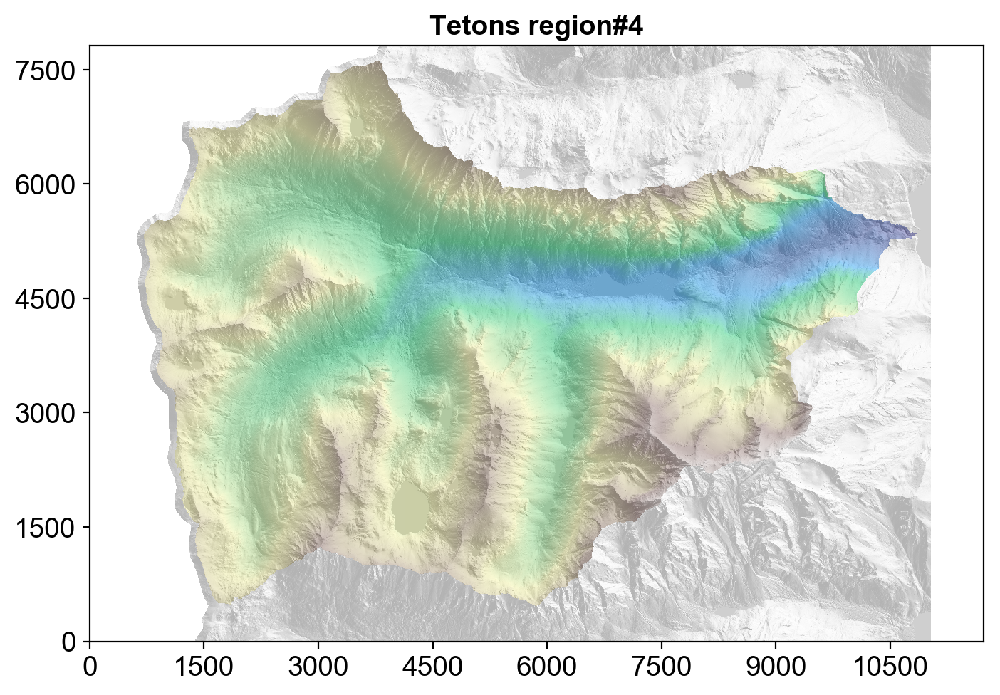

In [5]:
sl.plot.plot_roi_shaded_relief(interp_method='none')

## Preprocess DTM (fix loops etc)

In [6]:
%time sl.preprocess.do()


**Preprocess begin**
Precondition gradient vector field by fixing loops & blockages
Finding blockages...found 14225...done
Finding and fixing loops...
...done
Fixing blockages...
...done
Mask out bad uv pixels...done
**Preprocess end**

CPU times: user 32.3 s, sys: 727 ms, total: 33 s
Wall time: 32.9 s


## Trace streamlines

In [7]:
%autosave 0
%time sl.trace.do()
%autosave 120

Autosave disabled

**Trace begin**
Integrating trajectories...
Generating seed points...shuffling...padding for 32 CL work items/group: 1000->1024...done
GPU/OpenCL device global memory limit for streamline trajectories: 3.6GB
GPU/OpenCL device memory required for streamline trajectories: 4MB => no need to chunkify
Total number of kernel instances: 1,024
Number of chunks = seed point array divisor: 1
Chunk size = number of kernel instances per chunk: 1,024
Downstream: downup=0 sgn(uv)=+1.0 chunk=0 seeds: 0+1000 => 1000
Seed point buffer size = 1000.0*8 bytes
0.0% 62.5% 100.0% 
Upstream:   downup=1 sgn(uv)=-1.0 chunk=0 seeds: 0+1000 => 1000
Seed point buffer size = 1000.0*8 bytes
0.0% 62.5% 100.0% 
Building streamlines compressed array
Streamlines actual array allocation:  size=2MB
Computing streamlines statistics
    downstream                           upstream                         
           min        mean          max       min        mean          max
l   736.626404  999.85589

Autosaving every 120 seconds


In [8]:
import pandas as pd
ddf=pd.DataFrame(sl.trace.traj_stats_df.loc['downstream'].T)
udf=pd.DataFrame(sl.trace.traj_stats_df.loc['upstream'].T)
ddf.style.format("{:.3g}").set_properties(**{'font-size':'140%'})\
    .set_caption('Downstreamline statistics:')
udf.style.format("{:.3g}").set_properties(**{'font-size':'140%'})\
    .set_caption('Upstreamline statistics:')

,min,mean,max
l,737,1e+03,1e+03
n,606,820,830
ds,1.21,1.22,1.24


,min,mean,max
l,4.23,849,1e+03
n,3,822,2e+03
ds,0.0858,1.14,1.98


Autosave disabled
Plotting all 1,000 down streamlines
Progress: 1%...2%...3%...4%...5%...6%...7%...8%...9%...10%...11%...12%...13%...14%...15%...16%...17%...18%...19%...20%...21%...22%...23%...24%...25%...26%...27%...28%...29%...30%...31%...32%...33%...34%...35%...36%...37%...38%...39%...40%...41%...42%...43%...44%...45%...46%...47%...48%...49%...50%...51%...52%...53%...54%...55%...56%...57%...58%...59%...60%...61%...62%...63%...64%...65%...66%...67%...68%...69%...70%...71%...72%...73%...74%...75%...76%...77%...78%...79%...80%...81%...82%...83%...84%...85%...86%...87%...88%...89%...90%...91%...92%...93%...94%...95%...96%...97%...98%...99%...100%
Plotting all 1,000 up streamlines
Progress: 1%...2%...3%...4%...5%...6%...7%...8%...9%...10%...11%...12%...13%...14%...15%...16%...17%...18%...19%...20%...21%...22%...23%...24%...25%...26%...27%...28%...29%...30%...31%...32%...33%...34%...35%...36%...37%...38%...39%...40%...41%...42%...43%...44%...45%...46%...47%...48%...49%...50%...51%...52%..

Autosaving every 120 seconds


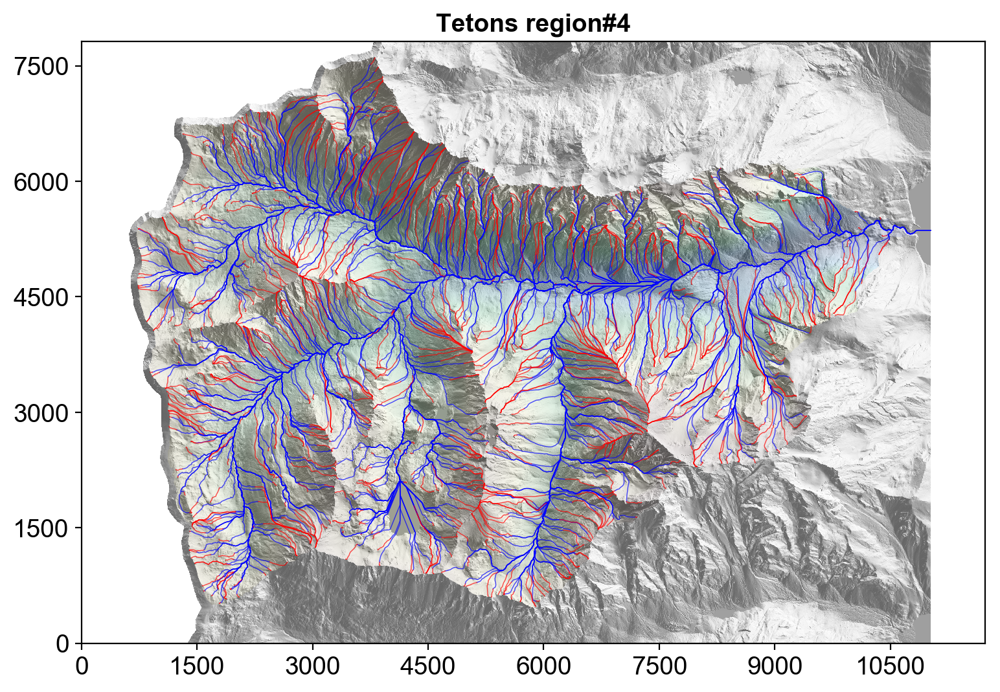

In [9]:
%autosave 0
sl.plot.plot_streamlines(window_size_factor=3)
%autosave 120

## Viz streamline flow concentrations

Recording figure "dsla"
Recording figure "dslt"


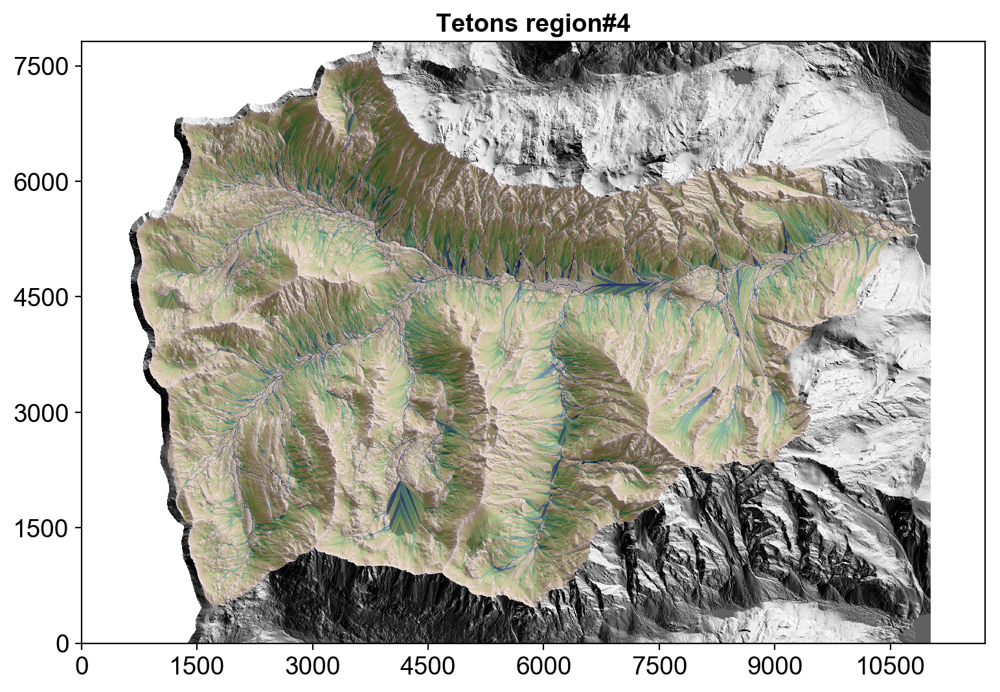

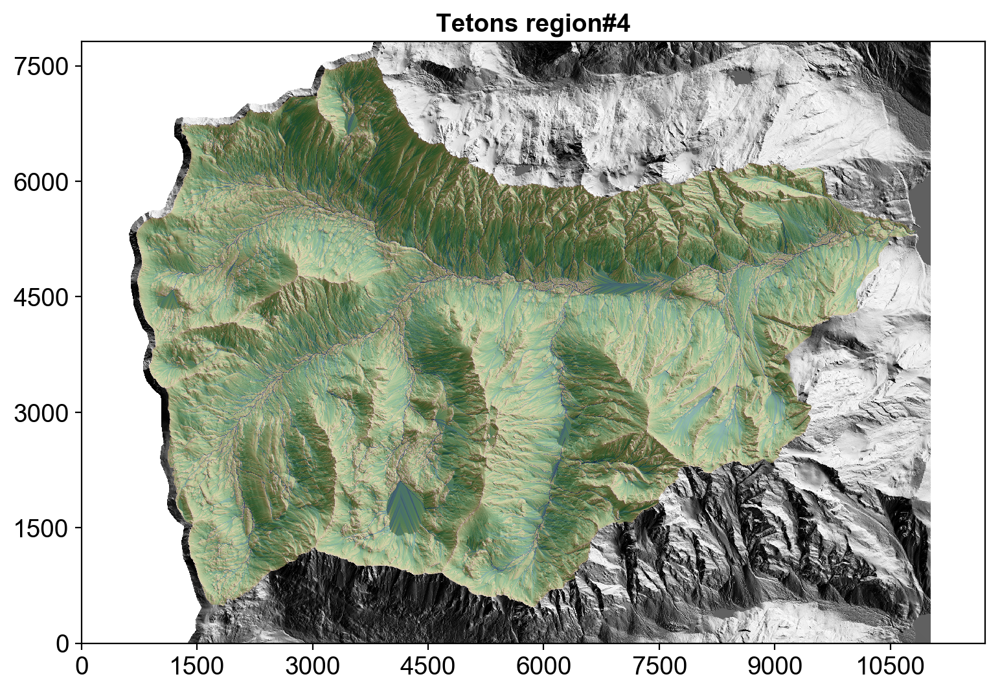

In [10]:
sl.plot.plot_flow_maps(window_size_factor=3)

## Analyze streamline distributions

In [11]:
# sl.analysis.do()

In [12]:
# sl.plot.plot_distributions()

## Map channels, segments & hillslope lengths

In [13]:
sl.analysis.search_cdf_min=0.9
sl.analysis.search_cdf_max=1

In [14]:
sl.mapping.pass1()


**Pass#1 begin**
Midslopes...done
Ridges...done
Channels...done
Connecting channel pixels...
...done
Thinning channels...skeletonizing...done
Mapping channel heads...
...done
Counting down channels...
...done
Flagging down channels...
...done
Labeling confluences...
...done
Flagging down channels...
...done
Flagging down channels...
...done
Flagging down channels...
...done
Segmenting channels...number of segments=390
...done
Linking hillslopes...
...done
Segmenting hillslopes...
...done
Subsegmenting left & right flanks...number of subsegments=780
...done
Prepare for mapping HSL from midslopes
**Pass#1 end**


In [15]:
sl.mapping.pass2()


**Pass#2 begin**
0.0% -389 
Channel threshold = 150.0m
FMM mean HSL   = 45.1m
Trace mean HSL = 70.8m
0.1% -388 
Channel threshold = 150.0m
FMM mean HSL   = 41.0m
Trace mean HSL = 47.0m
0.3% -387 
Channel threshold = 205.2m
FMM mean HSL   = 83.6m
Trace mean HSL = 172.7m
0.4% -386 
Channel threshold = 150.0m
FMM mean HSL   = 89.1m
Trace mean HSL = 122.4m
0.5% -385 
Channel threshold = 131.2m
FMM mean HSL   = 64.9m
Trace mean HSL = 145.7m
0.6% -384 
Channel threshold = 150.0m
FMM mean HSL   = 8.0m
Trace mean HSL = 8.0m
0.8% -383 
Channel threshold = 150.0m
FMM mean HSL   = 35.4m
Trace mean HSL = 65.7m
0.9% -382 
Channel threshold = 233.1m
FMM mean HSL   = 226.8m
Trace mean HSL = 314.2m
1.0% -381 
Channel threshold = 51.1m
FMM mean HSL   = 61.9m
Trace mean HSL = 77.5m
1.2% -380 
Channel threshold = 226.1m
FMM mean HSL   = 87.7m
Trace mean HSL = 223.5m
1.3% -379 
Channel threshold = 150.0m
FMM mean HSL   = 91.1m
Trace mean HSL = 152.7m
1.4% -378 
Channel threshold = 85.9m
FMM mean HSL   = 

12.5% -292 
Channel threshold = 150.0m
FMM mean HSL   = 14.5m
Trace mean HSL = 14.4m
12.6% -291 
Channel threshold = 242.2m
FMM mean HSL   = 112.0m
Trace mean HSL = 241.1m
12.7% -290 
Channel threshold = 150.0m
FMM mean HSL   = 99.8m
Trace mean HSL = 133.7m
12.8% -289 
Channel threshold = 150.0m
FMM mean HSL   = 17.0m
Trace mean HSL = 17.0m
13.0% -288 
Channel threshold = 150.0m
FMM mean HSL   = 94.3m
Trace mean HSL = 157.5m
13.1% -287 
Channel threshold = 150.0m
FMM mean HSL   = 54.7m
Trace mean HSL = 93.1m
13.2% -286 
Channel threshold = 168.3m
FMM mean HSL   = 110.1m
Trace mean HSL = 170.5m
13.4% -285 
Channel threshold = 150.0m
FMM mean HSL   = 45.0m
Trace mean HSL = 82.0m
13.5% -284 
Channel threshold = 166.9m
FMM mean HSL   = 124.0m
Trace mean HSL = 202.1m
13.6% -283 
Channel threshold = 150.0m
FMM mean HSL   = 30.0m
Trace mean HSL = 39.4m
13.7% -282 
Channel threshold = 124.1m
FMM mean HSL   = 93.2m
Trace mean HSL = 145.7m
13.9% -281 
Channel threshold = 150.0m
FMM mean HSL   = 

Trace mean HSL = 121.6m
24.9% -195 
Channel threshold = 150.0m
FMM mean HSL   = 126.3m
Trace mean HSL = 184.5m
25.0% -194 
Channel threshold = 133.8m
FMM mean HSL   = 86.7m
Trace mean HSL = 133.5m
25.2% -193 
Channel threshold = 150.0m
FMM mean HSL   = 82.2m
Trace mean HSL = 142.6m
25.3% -192 
Channel threshold = 218.0m
FMM mean HSL   = 90.2m
Trace mean HSL = 174.0m
25.4% -191 
Channel threshold = 150.0m
FMM mean HSL   = 31.3m
Trace mean HSL = 68.3m
25.5% -190 
Channel threshold = 278.5m
FMM mean HSL   = 220.1m
Trace mean HSL = 379.3m
25.7% -189 
Channel threshold = 150.0m
FMM mean HSL   = 48.4m
Trace mean HSL = 108.6m
25.8% -188 
Channel threshold = 150.0m
FMM mean HSL   = 87.8m
Trace mean HSL = 148.0m
25.9% -187 
Channel threshold = 150.0m
FMM mean HSL   = 192.7m
Trace mean HSL = 442.2m
26.1% -186 
Channel threshold = 150.0m
FMM mean HSL   = 21.0m
Trace mean HSL = 18.9m
26.2% -185 
Channel threshold = 326.5m
FMM mean HSL   = 198.8m
Trace mean HSL = 331.3m
26.3% -184 
Channel threshol

37.1% -100 
Channel threshold = 150.0m
FMM mean HSL   = 37.0m
Trace mean HSL = 37.0m
37.2% -99 
Channel threshold = 403.2m
FMM mean HSL   = 181.0m
Trace mean HSL = 452.2m
37.4% -98 
Channel threshold = 150.0m
FMM mean HSL   = 36.0m
Trace mean HSL = 34.7m
37.5% -97 
Channel threshold = 150.0m
FMM mean HSL   = 96.5m
Trace mean HSL = 168.0m
37.6% -96 
Channel threshold = 150.0m
FMM mean HSL   = 16.3m
Trace mean HSL = 16.1m
37.7% -95 
Channel threshold = 150.0m
FMM mean HSL   = 77.3m
Trace mean HSL = 156.7m
37.9% -94 
Channel threshold = 262.7m
FMM mean HSL   = 82.5m
Trace mean HSL = 176.0m
38.0% -93 
Channel threshold = 861.9m
FMM mean HSL   = 274.6m
Trace mean HSL = 624.0m
38.1% -92 
Channel threshold = 150.0m
FMM mean HSL   = 26.0m
Trace mean HSL = 29.7m
38.3% -91 
Channel threshold = 150.0m
FMM mean HSL   = 17.0m
Trace mean HSL = 17.0m
38.4% -90 
Channel threshold = 150.0m
FMM mean HSL   = 36.6m
Trace mean HSL = 90.7m
38.5% -89 
Channel threshold = 150.0m
FMM mean HSL   = 64.2m
Trace m

Trace mean HSL = 449.5m
49.6% -3 
Channel threshold = 193.5m
FMM mean HSL   = 200.9m
Trace mean HSL = 281.9m
49.7% -2 
Channel threshold = 119.6m
FMM mean HSL   = 92.1m
Trace mean HSL = 133.5m
49.8% -1 
Channel threshold = 201.0m
FMM mean HSL   = 187.1m
Trace mean HSL = 251.5m
49.9% +1 
Channel threshold = 688.5m
FMM mean HSL   = 196.5m
Trace mean HSL = 337.5m
50.1% +2 
Channel threshold = 124.3m
FMM mean HSL   = 78.6m
Trace mean HSL = 123.5m
50.2% +3 
Channel threshold = 150.0m
FMM mean HSL   = 81.0m
Trace mean HSL = 128.3m
50.3% +4 
Channel threshold = 150.0m
FMM mean HSL   = 89.7m
Trace mean HSL = 118.3m
50.4% +5 
Channel threshold = 150.0m
FMM mean HSL   = 66.0m
Trace mean HSL = 98.0m
50.6% +6 
Channel threshold = 150.0m
FMM mean HSL   = 72.9m
Trace mean HSL = 115.7m
50.7% +7 
Channel threshold = 204.9m
FMM mean HSL   = 112.9m
Trace mean HSL = 212.4m
50.8% +8    --- (problem measuring HSL using FM)
51.0% +9 
Channel threshold = 150.0m
FMM mean HSL   = 51.6m
Trace mean HSL = 114.8m


62.1% +96 
Channel threshold = 150.0m
FMM mean HSL   = 8.8m
Trace mean HSL = 9.5m
62.3% +97 
Channel threshold = 998.3m
FMM mean HSL   = 107.2m
Trace mean HSL = 183.5m
62.4% +98 
Channel threshold = 150.0m
FMM mean HSL   = 37.9m
Trace mean HSL = 57.8m
62.5% +99 
Channel threshold = 225.8m
FMM mean HSL   = 115.9m
Trace mean HSL = 250.0m
62.6% +100 
Channel threshold = 351.1m
FMM mean HSL   = 150.1m
Trace mean HSL = 263.3m
62.8% +101 
Channel threshold = 150.0m
FMM mean HSL   = 53.8m
Trace mean HSL = 98.3m
62.9% +102 
Channel threshold = 150.0m
FMM mean HSL   = 10.0m
Trace mean HSL = 10.1m
63.0% +103 
Channel threshold = 328.3m
FMM mean HSL   = 70.4m
Trace mean HSL = 137.3m
63.2% +104 
Channel threshold = 150.0m
FMM mean HSL   = 34.5m
Trace mean HSL = 41.0m
63.3% +105 
Channel threshold = 150.0m
FMM mean HSL   = 76.2m
Trace mean HSL = 148.0m
63.4% +106 
Channel threshold = 150.0m
FMM mean HSL   = 10.5m
Trace mean HSL = 10.7m
63.5% +107 
Channel threshold = 150.0m
FMM mean HSL   = 46.4m
T

FMM mean HSL   = 77.8m
Trace mean HSL = 118.6m
74.6% +193 
Channel threshold = 150.0m
FMM mean HSL   = 37.8m
Trace mean HSL = 77.4m
74.7% +194 
Channel threshold = 191.8m
FMM mean HSL   = 104.0m
Trace mean HSL = 192.3m
74.8% +195 
Channel threshold = 213.1m
FMM mean HSL   = 140.1m
Trace mean HSL = 217.9m
75.0% +196 
Channel threshold = 183.4m
FMM mean HSL   = 113.6m
Trace mean HSL = 201.7m
75.1% +197 
Channel threshold = 150.0m
FMM mean HSL   = 37.5m
Trace mean HSL = 58.7m
75.2% +198 
Channel threshold = 459.2m
FMM mean HSL   = 73.9m
Trace mean HSL = 89.3m
75.4% +199 
Channel threshold = 178.6m
FMM mean HSL   = 105.2m
Trace mean HSL = 200.7m
75.5% +200 
Channel threshold = 150.0m
FMM mean HSL   = 36.0m
Trace mean HSL = 70.3m
75.6% +201 
Channel threshold = 150.0m
FMM mean HSL   = 27.6m
Trace mean HSL = 51.4m
75.7% +202 
Channel threshold = 150.0m
FMM mean HSL   = 79.8m
Trace mean HSL = 125.8m
75.9% +203 
Channel threshold = 150.0m
FMM mean HSL   = 69.4m
Trace mean HSL = 115.9m
76.0% +2

86.9% +289 
Channel threshold = 150.0m
FMM mean HSL   = 37.0m
Trace mean HSL = 37.0m
87.0% +290 
Channel threshold = 549.4m
FMM mean HSL   = 212.1m
Trace mean HSL = 500.0m
87.2% +291 
Channel threshold = 104.7m
FMM mean HSL   = 71.1m
Trace mean HSL = 101.9m
87.3% +292    --- (problem mapping channels & subsegments)
87.4% +293 
Channel threshold = 171.8m
FMM mean HSL   = 89.8m
Trace mean HSL = 144.6m
87.5% +294 
Channel threshold = 189.3m
FMM mean HSL   = 166.9m
Trace mean HSL = 236.6m
87.7% +295 
Channel threshold = 150.0m
FMM mean HSL   = 22.7m
Trace mean HSL = 23.2m
87.8% +296 
Channel threshold = 150.0m
FMM mean HSL   = 33.0m
Trace mean HSL = 46.3m
87.9% +297 
Channel threshold = 150.0m
FMM mean HSL   = 70.5m
Trace mean HSL = 122.9m
88.1% +298 
Channel threshold = 150.0m
FMM mean HSL   = 42.0m
Trace mean HSL = 42.0m
88.2% +299 
Channel threshold = 127.6m
FMM mean HSL   = 81.0m
Trace mean HSL = 138.4m
88.3% +300 
Channel threshold = 150.0m
FMM mean HSL   = 21.6m
Trace mean HSL = 21.4

Trace mean HSL = 124.4m
99.6% +388 
Channel threshold = 419.4m
FMM mean HSL   = 124.1m
Trace mean HSL = 302.6m
99.7% +389 
Channel threshold = 150.0m
FMM mean HSL   = 52.5m
Trace mean HSL = 94.1m
99.9% +390    --- (problem measuring HSL using FM)
100.0% 
**Pass#2 end**


In [16]:
sl.mapping.pass3()


**Pass#3 begin**
Connecting channel pixels...
...done
Thinning channels...skeletonizing...done
Mapping channel heads...
...done
Counting down channels...
...done
Flagging down channels...
...done
Mapping hillslope lengths from midslopes...dilation with 51m (17-pixel) width filter...mean filtering with 60m (20-pixel) diameter disk...done
Computing hillslope aspect with median filter radii 4m (slope), 50m (uv)...done
Computing hillslope length-aspect function...done
Computing hillslope length-aspect statistics...done
**Pass#3 end**


## Viz channels & segments

Recording figure "channels"
Recording figure "label"


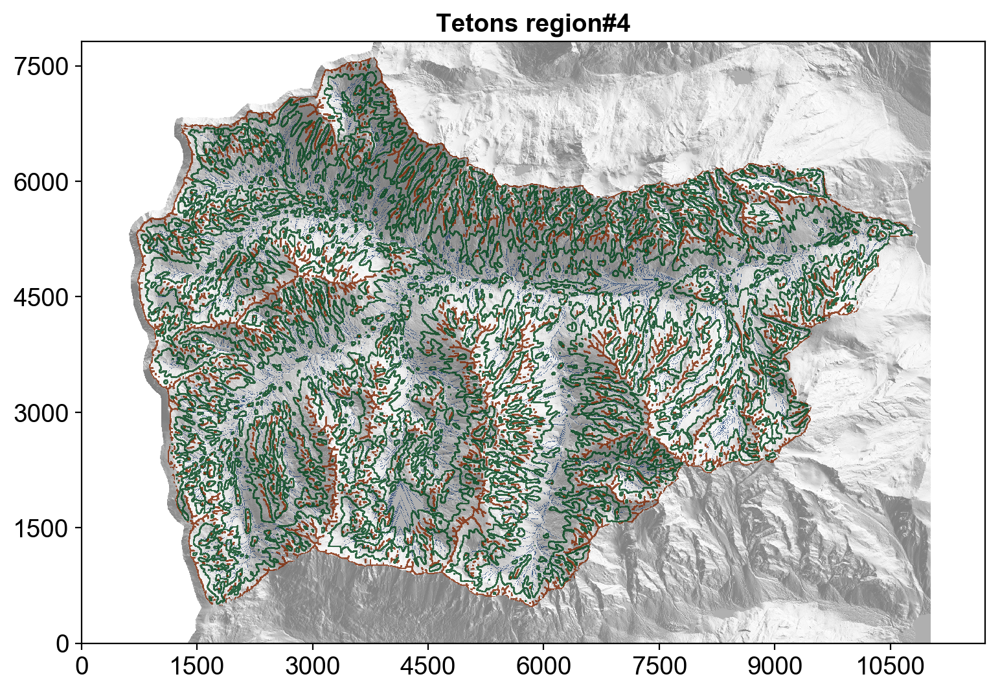

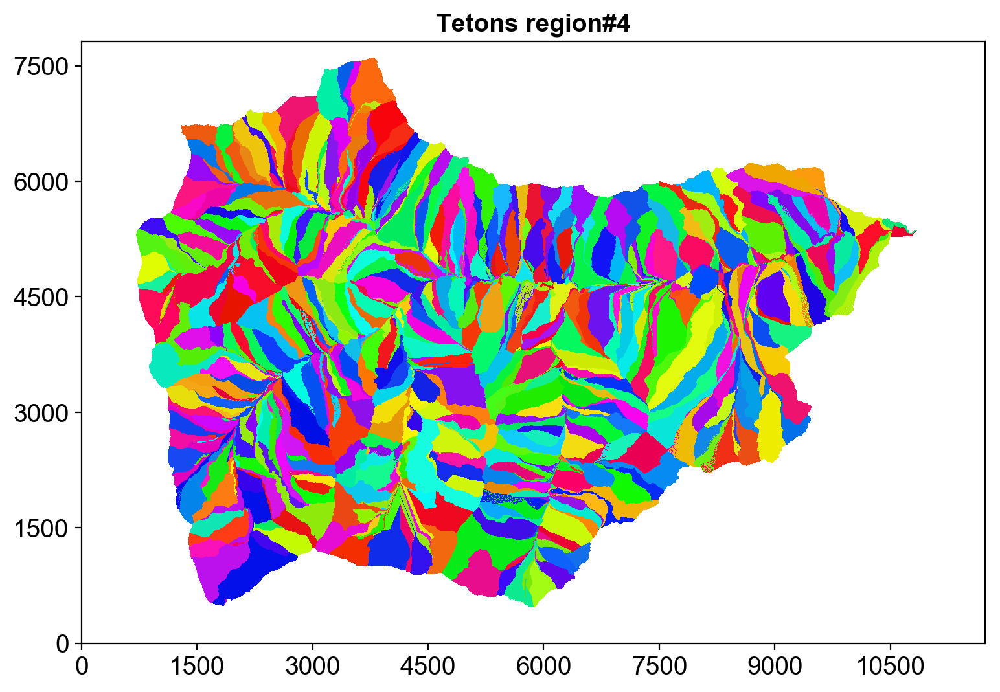

In [17]:
sl.plot.plot_channels(window_size_factor=3)
sl.plot.plot_segments(window_size_factor=3)

## Elevation & slope distributions

Recording figure "midslope_elevations_pdf"
Recording figure "slope_angles_pdf"


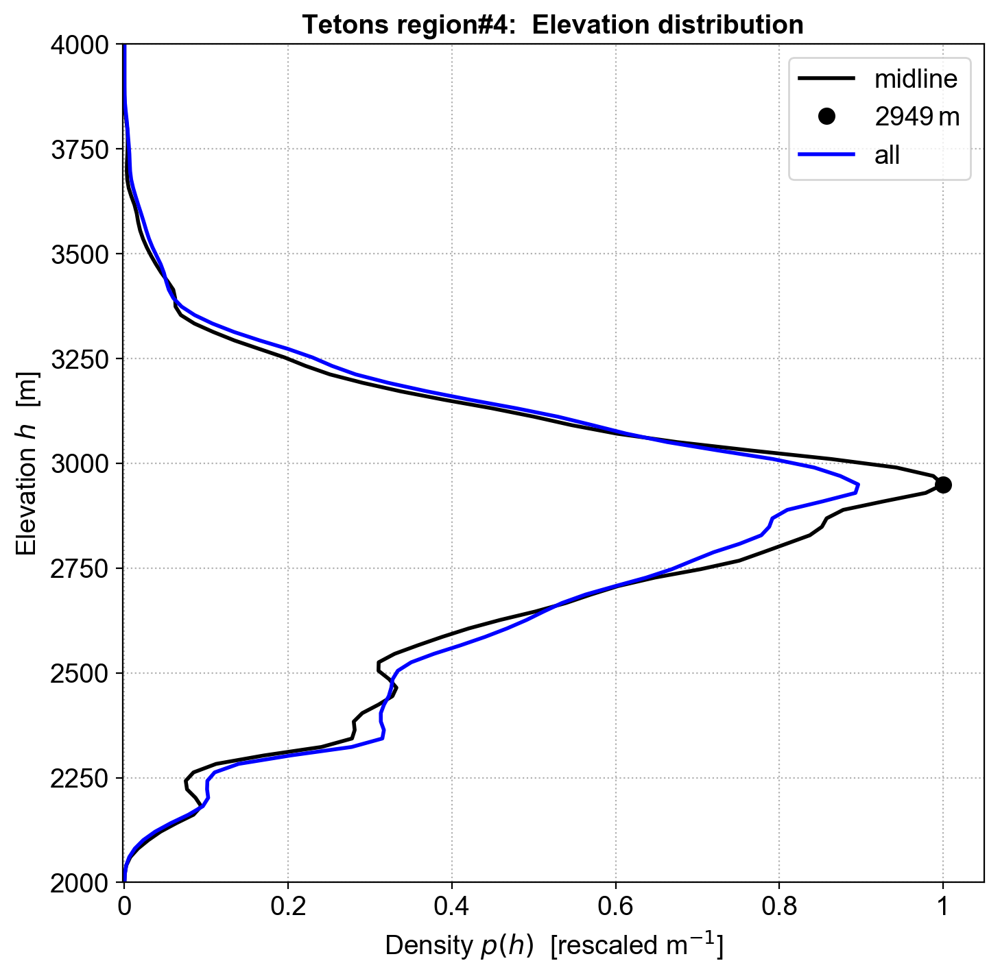

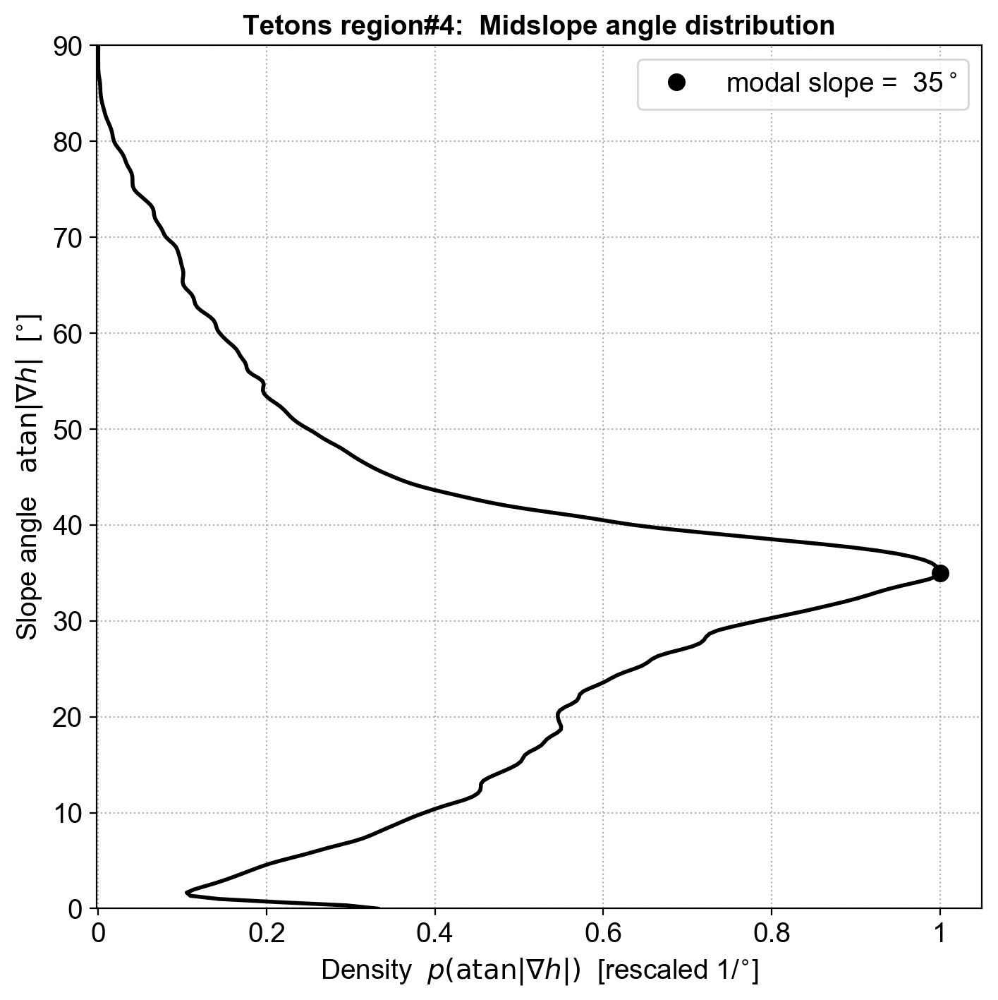

In [28]:
sl.analysis.compute_elevation_slope_pdfs(slope_max=90,
                                         h_min=2000, h_max=4000,
                                         bw_factor_h_midline=1,
                                         bw_factor_h_all=2,
                                         h_midline_max_bound=2000)
sl.plot.plot_midslope_elevations_pdf()
sl.plot.plot_slope_angles_pdf()

## Viz hillslope lengths

Recording figure "hsl"


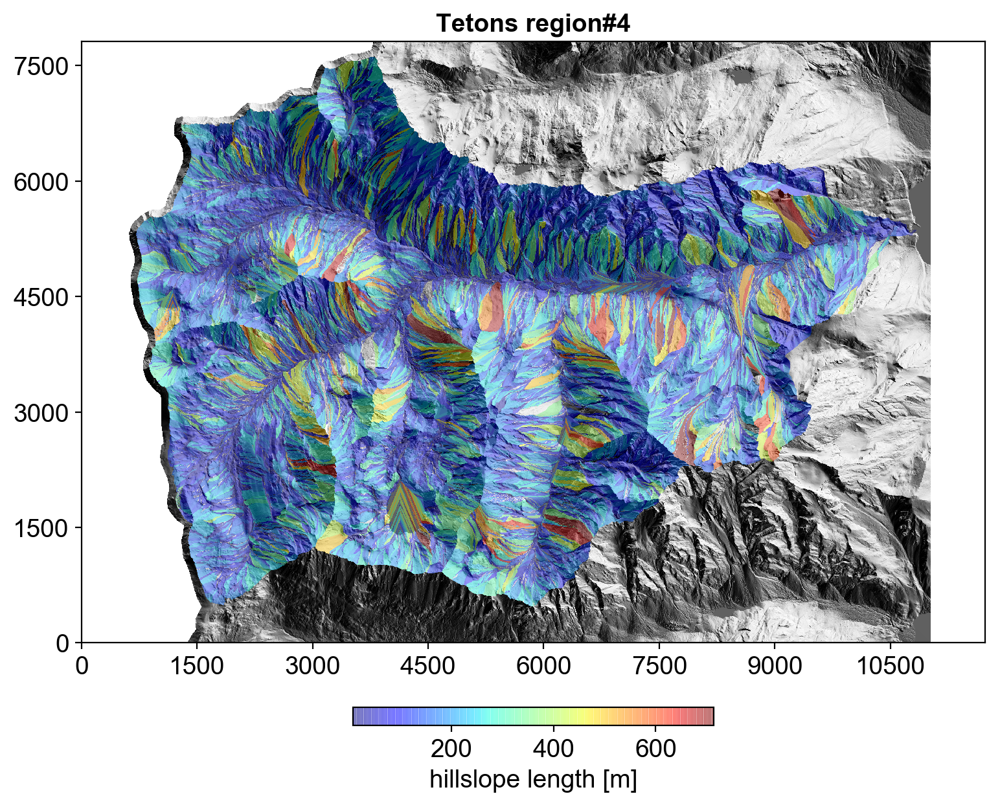

In [19]:
sl.plot.plot_hsl(window_size_factor=3)

Recording figure "hsl_contours"


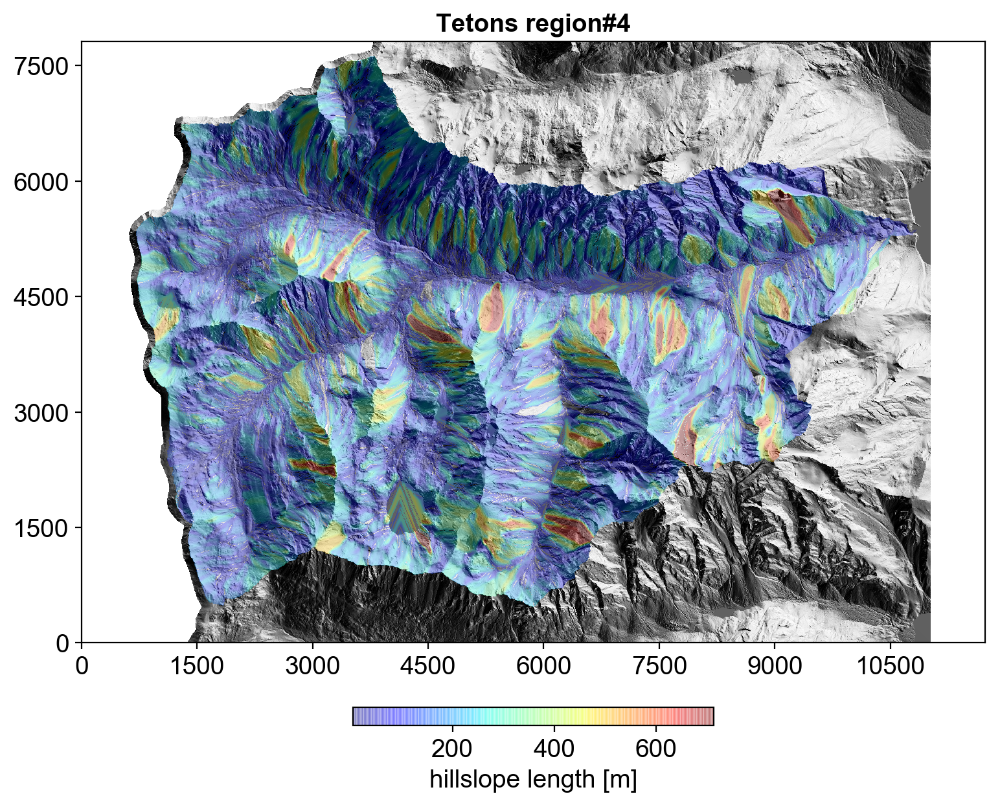

In [20]:
sl.plot.plot_hsl_contoured(window_size_factor=3)

## Viz aspect, hillslope length

Recording figure "aspect"


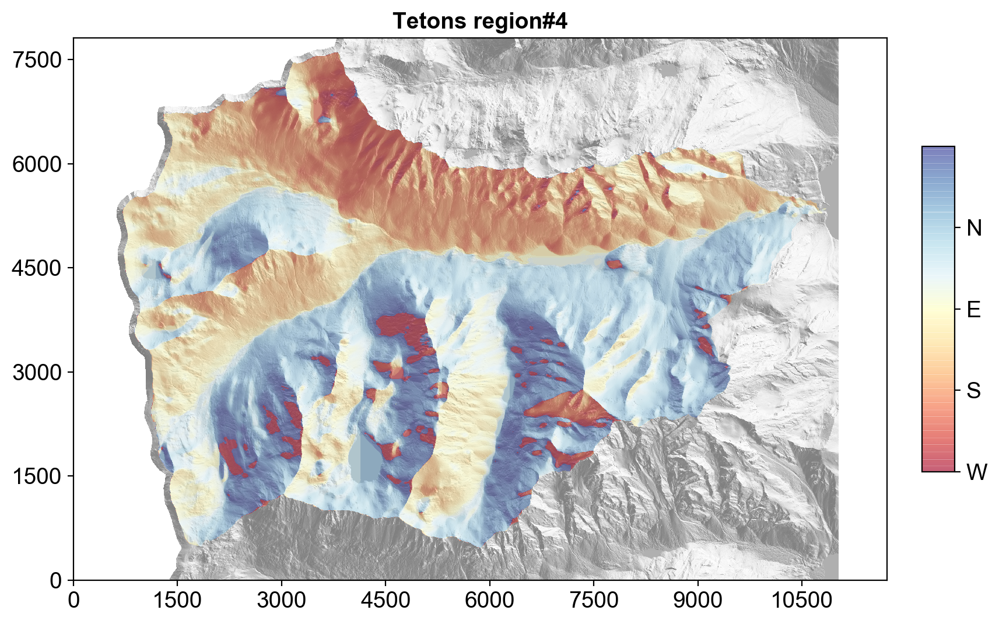

In [21]:
sl.plot.plot_aspect(window_size_factor=3.25)

In [22]:
sl.mapping.check_hsl_ns_disparity()

HSL mean ± σ(split), σ(all):	      203.5m ± 21.0m (split) 26.4m (all)
HSL N-S disparity:		      215.4mN vs 191.6mS   ∆≈23.8m
HSL N-S rel disparity vs variation:   11.7% (23.8m) NS vs 10.3% (21.0m)
HSL N-S disparity signal-noise ratio: ∆/σ = 1.1
					=> moderate north bias
N-facing vs S-facing HSL distribution comparison tests
  for f(HSL_N,S) with N,S bounds 45°<|±aspect|<135° from east
D_alpha =  c(alpha)*0.00701567
Kolmogorov-Smirnov: 0.08 p=6.71112e-103
Mann-Whitney:       0.46 p=4.41214e-94
Rank-sum:           20.5 p=8.82425e-94
Student's t:        26.6 p=9.10771e-155
Welch:              26.9 p=3.81053e-158
P-P:                +9%


Recording figure "hsl_aspect_distribution"


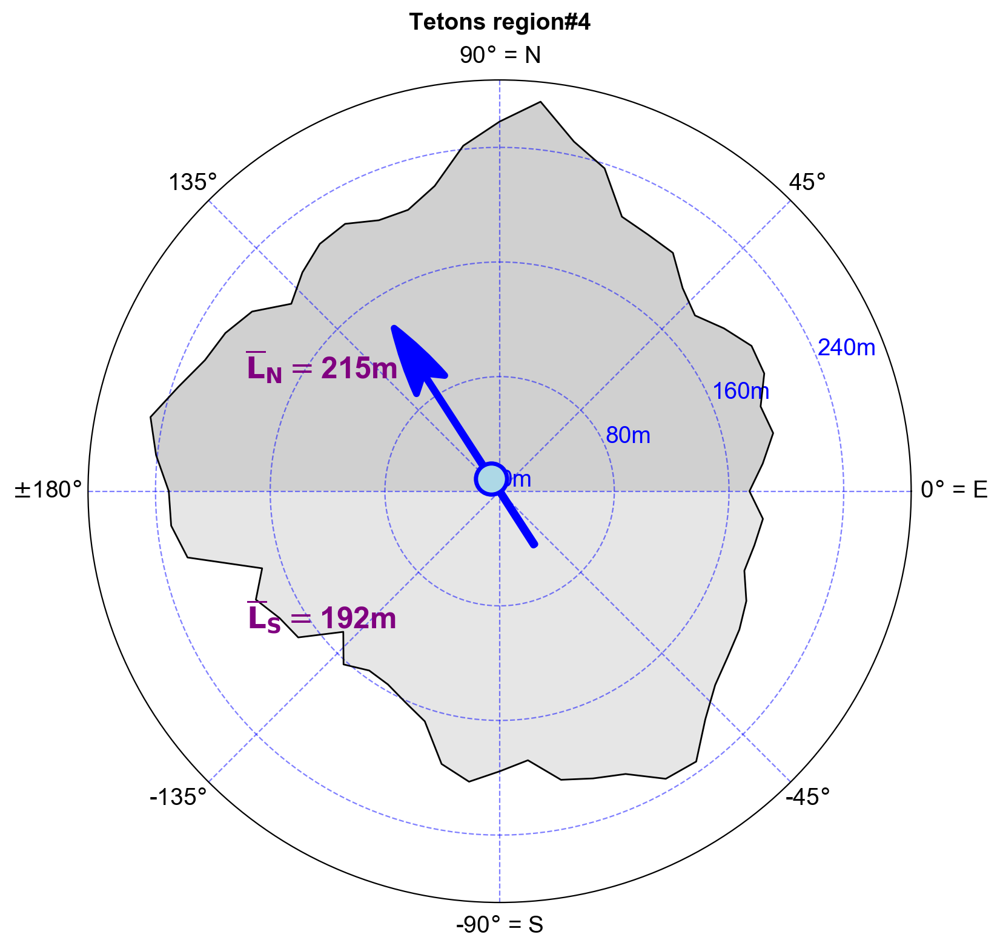

In [23]:
sl.plot.plot_hsl_aspect_distribution(window_size_factor=3)

## Hillslope length stats

Plotting hillslope length distributions...


KeyboardInterrupt: 

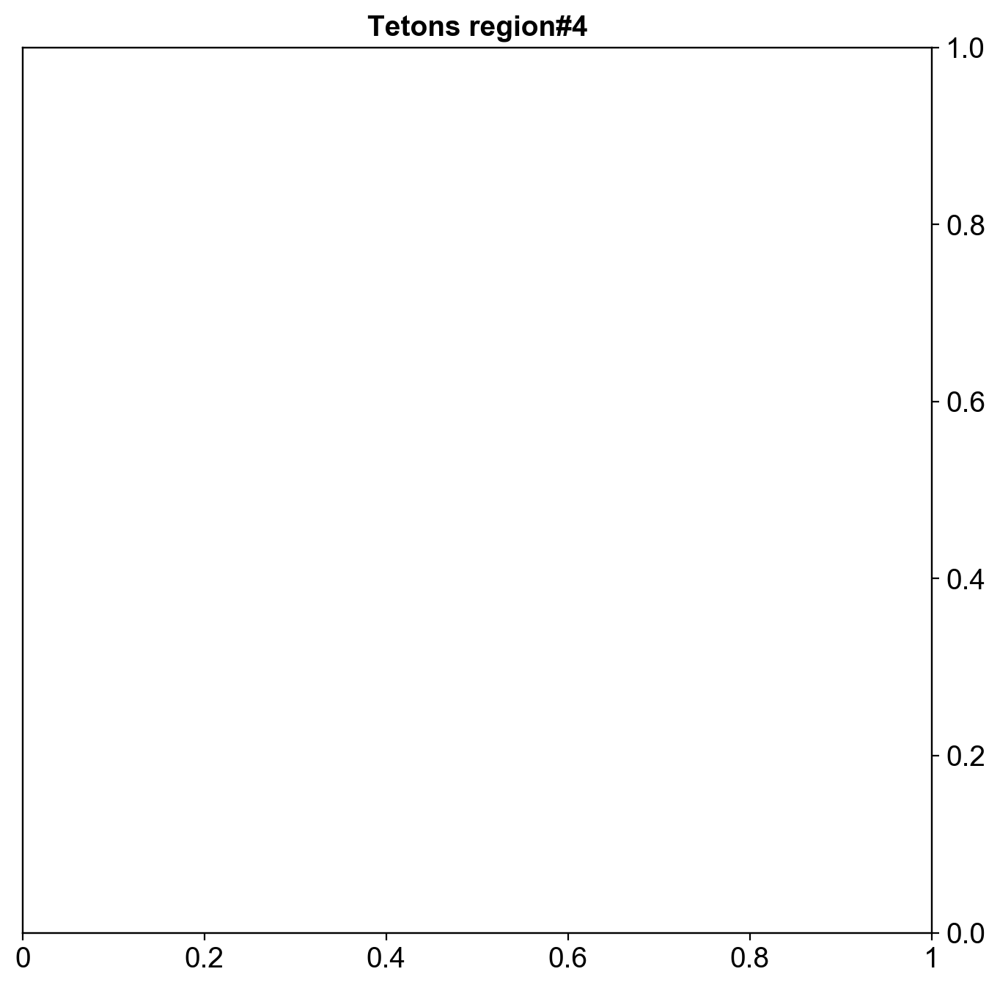

In [24]:
sl.plot.plot_hsl_distributions()

In [ ]:
df = sl.mapping.hsl_stats_df
df[:30].style.format("{:.3g}").set_properties(**{'font-size':'140%'}) \
         .set_caption('Hillslope length statistics:')
df.mean()

## Export plots

In [ ]:
sl.plot.figs

In [ ]:
sl.save.do()